In [1]:
from importlib import reload
from IPython.core.interactiveshell import InteractiveShell
%load_ext autoreload
InteractiveShell.ast_node_interactivity = "all"
import logging
logging.basicConfig(level=logging.DEBUG, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s')

In [2]:
import pandas as pd
import numpy as np
import os
import sys

module_path = os.path.abspath(os.path.join(".."))
if module_path not in sys.path:
    sys.path.append(module_path)

2024-10-16 09:24:15,260 - numexpr.utils - INFO - Note: NumExpr detected 32 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
2024-10-16 09:24:15,310 - numexpr.utils - INFO - NumExpr defaulting to 8 threads.
/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# Load Data

In [3]:
from utils.config import get_cfg_defaults
from utils.singleton_swaps_optimization import swaps_optimization_cfg
import sparse

config_path = "/cmnfs/proj/ORIGINS/SWAPS_exp/short_gradient/30min_3to45_7R_30min_exp_library_no_decoy_20241002_170450_580562/config_20241002_170450_580562.yaml"
cfg = get_cfg_defaults(swaps_optimization_cfg)
cfg.merge_from_file(config_path)
maxquant_result_ref = pd.read_pickle(cfg.DICT_PICKLE_PATH)

mobility_values_df = pd.read_csv(os.path.join(cfg.RESULT_PATH, "mobility_values.csv"))
ms1scans = pd.read_csv(os.path.join(cfg.RESULT_PATH, "ms1scans.csv"))
act_dir = os.path.join(cfg.RESULT_PATH, "results", "activation")

# Result Analysis

In [22]:
%autoreload 2
from result_analysis import result_analysis


eval_dir = "/cmnfs/proj/ORIGINS/SWAPS_exp/SWAPS_paper_figures/fig1_exp_dict/"
os.makedirs(eval_dir, exist_ok=True)

pept_act_sum_df = pd.read_csv(os.path.join(act_dir, "pept_act_sum.csv"))
infer_int_col = "pept_act_sum"
# TODO: fix im filter config
if cfg.RESULT_ANALYSIS.POST_PROCESSING.FILTER_BY_IM:
    pept_act_sum_filter_by_im_df = pd.read_csv(
        os.path.join(act_dir, "pept_act_sum_filter_by_im.csv")
    )
    # pept_act_sum_filter_by_im_df = pept_act_sum_filter_by_im_df.rename(
    #     {"sum_intensity": "sum_intensity_filter_by_im"}, axis=1
    # )
    pept_act_sum_df = pd.merge(
        left=pept_act_sum_df,
        right=pept_act_sum_filter_by_im_df,
        on=["mz_rank"],
        how="left",
        suffixes=("", "_filter_by_im"),
    )
    #infer_int_col = "pept_act_sum_filter_by_im"
    infer_int_col = "pept_act_sum_filter_by_im"


swaps_result = result_analysis.SWAPSResult(
    maxquant_dict=maxquant_result_ref,
    pept_act_sum_df=pept_act_sum_filter_by_im_df,
    infer_intensity_col=infer_int_col,
    fdr_thres=cfg.RESULT_ANALYSIS.FDR_THRESHOLD,
    log_sum_intensity_thres=cfg.RESULT_ANALYSIS.LOG_SUM_INTENSITY_THRESHOLD,
    save_dir=eval_dir,
    include_decoys=cfg.PREPARE_DICT.GENERATE_DECOY,
)
swaps_result.plot_intensity_corr(title=None, show_diag=False)

2024-10-16 10:07:04,448 - result_analysis.result_analysis - INFO - Drop na values in pept_act_sum_filter_by_im, Pept activation sum entries: 51800
2024-10-16 10:07:04,449 - result_analysis.result_analysis - INFO - Filtering the data by the sum of intensity threshold 2, number of entries before filtering 51800
2024-10-16 10:07:04,451 - result_analysis.result_analysis - INFO - Number of entries after filtering 51799
2024-10-16 10:07:04,453 - result_analysis.result_analysis - INFO - No decoy entries in the data, using FDR threshold of dictionary 0.2


In [23]:
swaps_result.plot_overlap_with_MQ(show_ref=False, level="precursor")

In [58]:
swaps_result.plot_intensity_corr(
    interactive=True,
    hover_data=[
        "mz_rank",
        "Charge",
        "Number of scans",
        "Number of isotopic peaks",
        "Retention length",
        "Modified sequence",
    ],
)

2024-10-16 11:04:15,890 - result_analysis.result_analysis - INFO - Number of entries after merging 51799 and columns Index(['Sequence', 'Length', 'Modifications', 'Modified sequence',
       'Oxidation (M) Probabilities', 'Oxidation (M) Score Diffs',
       'Acetyl (Protein N-term)', 'Oxidation (M)', 'Missed cleavages',
       'Proteins',
       ...
       'MS1_frame_idx_right_ref', 'IsoMZ', 'IsoAbundance', 'mz_rank', 'mz_bin',
       'mz_length', 'pept_batch_idx', 'Decoy', 'pept_act_sum_filter_by_im',
       'log_sum_intensity'],
      dtype='object', length=109)
2024-10-16 11:04:15,962 - utils.plot - INFO - Data: Intensity_log, pept_act_sum_filter_by_im_log, slope = 1.036, intercept = -0.696, Pearson's R = 0.942, Spearman's R = 0.931


## Candidate specific raw data visualization

In [24]:
act_dir = os.path.join(cfg.RESULT_PATH, "results", "activation")
act_3d = sparse.load_npz(os.path.join(act_dir, "im_rt_pept_act_coo_peptbatch0.npz"))

In [26]:
from utils.ims_utils import load_dotd_data

data, hdf_file_name = load_dotd_data(
    cfg.DATA_PATH, swaps_result_dir=cfg.EXPORT_DATA_HDF5_DIR
)

2024-10-16 10:10:34,452 - root - INFO - Importing data from /cmnfs/proj/ORIGINS/data/HeLa_sample_amount_and_LC_columns/raw_data/Hela_30min_5ug_R2_RA1_1_5163.d
2024-10-16 10:10:34,454 - root - INFO - Using .d import for /cmnfs/proj/ORIGINS/data/HeLa_sample_amount_and_LC_columns/raw_data/Hela_30min_5ug_R2_RA1_1_5163.d
2024-10-16 10:10:34,455 - root - INFO - Reading frame metadata for /cmnfs/proj/ORIGINS/data/HeLa_sample_amount_and_LC_columns/raw_data/Hela_30min_5ug_R2_RA1_1_5163.d
/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/alphatims/bruker.py:237: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is

In [61]:
np.log10(79621)

4.901027627804154

In [60]:
%autoreload 2
from utils.plot import plot_im_mz

mz_rank = 30783
ms1_range = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank,
    [
        "MS1_frame_idx_left_exp",
        "MS1_frame_idx_right_exp",
    ],
].values
precursor = '_'.join(map(str, maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank,
        [
            "Modified sequence",
            "Charge",
        ],
    ]
    .values[0]))
IsoMZ = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "IsoMZ"
].values[0]

df = data[
    {
        # "frame_indices": slice(int(ms1_range[0][0]) - 1, int(ms1_range[0][1]) + 1),
        "frame_indices": slice(
            ms1scans.loc[ms1_range[0][0], "Id"] - 1,
            ms1scans.loc[ms1_range[0][1], "Id"] + 1,
        ),
        "precursor_indices": [0],
        # # "scan_indices": slice(300, 800, 10),
        "mz_values": slice(IsoMZ.min() - 0.1, IsoMZ.max() + 0.1),
        # "mobility_values": [0.9, 1.0],
        # # "intensity_values": 50,
    }
]
im = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "mobility_values_center_exp"
].values
im_length = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "1/K0 length"
].values[0]
plot_im_mz(
    sliced_frame=df,
    mark_mz=maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank, "IsoMZ"
    ].values[0],
    distr_mz=maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank, "IsoAbundance"
    ].values[0],
    mark_im=[im - 0.5*im_length, im, im + 0.5*im_length],
    title = precursor,
    save_dir = os.path.join(eval_dir, "outlier_raw_data"),
    fig_spec_name="overestimated"+precursor+"_"+str(mz_rank),
)

2024-10-16 11:25:02,500 - matplotlib.colorbar - DEBUG - locator: <matplotlib.ticker.AutoLocator object at 0x7f347056e950>


In [ ]:
%autoreload 2
from utils.plot import plot_im_mz

mz_rank = 50905
ms1_range = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank,
    [
        "MS1_frame_idx_left_exp",
        "MS1_frame_idx_right_exp",
    ],
].values
precursor = '_'.join(map(str, maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank,
        [
            "Modified sequence",
            "Charge",
        ],
    ]
    .values[0]))
IsoMZ = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "IsoMZ"
].values[0]

df = data[
    {
        # "frame_indices": slice(int(ms1_range[0][0]) - 1, int(ms1_range[0][1]) + 1),
        "frame_indices": slice(
            ms1scans.loc[ms1_range[0][0], "Id"] - 1,
            ms1scans.loc[ms1_range[0][1], "Id"] + 1,
        ),
        "precursor_indices": [0],
        # # "scan_indices": slice(300, 800, 10),
        "mz_values": slice(IsoMZ.min() - 0.1, IsoMZ.max() + 0.1),
        # "mobility_values": [0.9, 1.0],
        # # "intensity_values": 50,
    }
]
im = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "mobility_values_center_exp"
].values
im_length = maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"] == mz_rank, "1/K0 length"
].values[0]
plot_im_mz(
    sliced_frame=df,
    mark_mz=maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank, "IsoMZ"
    ].values[0],
    distr_mz=maxquant_result_ref.loc[
        maxquant_result_ref["mz_rank"] == mz_rank, "IsoAbundance"
    ].values[0],
    mark_im=[im - 0.5*im_length, im, im + 0.5*im_length],
    title = precursor,
    save_dir = os.path.join(eval_dir, "outlier_raw_data"),
    fig_spec_name="underestimated"+precursor+"_"+str(mz_rank),
)

2024-10-16 10:38:43,580 - matplotlib.colorbar - DEBUG - locator: <matplotlib.ticker.AutoLocator object at 0x7f3491fd8b80>


# Exam individual peptide image

## Find candidates to plot

In [99]:
a = maxquant_result_ref["mz_bin"].value_counts()

In [112]:
maxquant_result_ref.loc[
    (maxquant_result_ref["mz_bin"] == 760.38),
    ["mz_bin", "MS1_frame_idx_left_exp", "MS1_frame_idx_right_exp", "mz_rank"],
]

,mz_bin,MS1_frame_idx_left_exp,MS1_frame_idx_right_exp,mz_rank
7594,760.38,852.0,868.0,23915
15426,760.38,1099.0,1108.0,23922
16989,760.38,1143.0,1153.0,23923
18129,760.38,1174.0,1184.0,23916
19574,760.38,1208.0,1222.0,23924
25128,760.38,1361.0,1370.0,23918
25651,760.38,1376.0,1383.0,23913
29441,760.38,1465.0,1480.0,23914
34165,760.38,1598.0,1611.0,23919
34446,760.38,1605.0,1619.0,23920


## Deconvolution with heatmap

- frame number 1055, candidate mz rank 8553, 8555
- frame number 828, candidate mz rank 19100, 19103
- fraome number 1608, candidate mz rank 23919, 23920

In [135]:
maxquant_result_ref.loc[
    maxquant_result_ref["mz_rank"].isin([8553, 8555]),
    ["1/K0 length", "mobility_values_center_exp", "mz_rank"],
]

,1/K0 length,mobility_values_center_exp,mz_rank
13669,0.063347,0.898293,8555
13806,0.115991,0.941988,8553


In [132]:
from optimization.inference import process_one_frame_ims
import matplotlib.pyplot as plt

frame_idx = 1609
(
    peaks_df,
    im_pept_act_coo,
    frame_array,
    candidate_array,
    im_pept_act,
    candidate_precursor_by_rt,
    all_frame_pept_idx,
) = process_one_frame_ims(
    data=data,
    ms1scans=ms1scans,
    ms1_frame_idx=frame_idx,
    maxquant_result_ref_with_im_index_sortmz=maxquant_result_ref,
    mobility_values=mobility_values_df,
    debug=True,
    mz_bin_digits=2,
    extract_im_peak=False,
    return_im_pept_act=True,
)
a = np.where(all_frame_pept_idx == 23919)
b = np.where(all_frame_pept_idx == 23920)
# c = np.where(all_frame_pept_idx == 31371)
candidate_act = im_pept_act[:, [a, b]].reshape(-1, 2)
candidate_mz_pattern = candidate_array[[a, b], :].reshape(2, candidate_array.shape[1])
non_zero_columns = np.where(np.any(candidate_mz_pattern != 0, axis=0))[0]

candidate_mz_pattern = candidate_mz_pattern[:, non_zero_columns]
frame_candidate_mz_range = frame_array[:, non_zero_columns].reshape(
    -1, len(non_zero_columns)
)
# frame_array = frame_array[:, non_zero_columns]
non_zero_rows = np.where(np.any(frame_candidate_mz_range != 0, axis=1))[0]
frame_candidate_mz_range = frame_candidate_mz_range[non_zero_rows, :]
candidate_act = candidate_act[non_zero_rows, :]

2024-10-16 14:30:28,043 - optimization.inference - DEBUG - Start data preparation.
2024-10-16 14:30:28,160 - optimization.inference - DEBUG - Frame data shape: 437098
2024-10-16 14:30:28,164 - optimization.inference - INFO - Number of candidates by RT in frame 1609: 496
/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/optimization/inference.py:790: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-16 14:30:28,341 - optimization.inference - DEBUG - Number of mz values in candidate, frame and joint:2656, 86516, 86536
2024-10-16 14:30:28,384 - optimization.inference - DEBUG - min and max mz index: 1821 72462
2024-10-16 14:30:28,386 - optimization.inference - DEBUG - Number of mz values in filtered candidate index: 2656
2024-10-16 14:30:28,570 - optimization.inference - DEBUG - Start optimization with s

In [134]:
from utils.plot import save_plot

plt.rcParams.update({"font.size": 12})
plt.imshow(frame_candidate_mz_range.T, aspect="auto", cmap="hot", interpolation="none")
plt.ylabel("m/z Bin Index")
plt.xlabel("Ion Mobility Index")
plt.colorbar()
save_plot(
    os.path.join(eval_dir, "optimzation_ilustration", str(frame_idx)),
    "heat_map",
    "ms1_frame",
)
plt.imshow(candidate_mz_pattern.T, aspect="auto", cmap="hot", interpolation="none")
plt.ylabel("m/z Bin Index")
plt.xlabel("Candidate Precursors")
plt.xticks(ticks=[0, 1], labels=["A", "B"])
plt.colorbar()
save_plot(
    os.path.join(eval_dir, "optimzation_ilustration", str(frame_idx)),
    "heat_map",
    "dictioanry_mz_pattern",
)
plt.imshow(candidate_act.T, aspect="auto", cmap="hot", interpolation="none")
plt.ylabel("Candidate Precursors")
plt.yticks(ticks=[0, 1], labels=["A", "B"])
plt.xlabel("Ion Mobility Index")
plt.colorbar()
save_plot(
    os.path.join(eval_dir, "optimzation_ilustration", str(frame_idx)),
    "heat_map",
    "candidate_act",
)

Text(0, 0.5, 'm/z Bin Index')

Text(0.5, 0, 'Ion Mobility Index')

2024-10-16 14:30:38,319 - matplotlib.colorbar - DEBUG - locator: <matplotlib.ticker.AutoLocator object at 0x7f3242aa4c10>


Text(0, 0.5, 'm/z Bin Index')

Text(0.5, 0, 'Candidate Precursors')

([<matplotlib.axis.XTick at 0x7f3242af2f20>,
 [Text(0, 0, 'A'), Text(1, 0, 'B')])

2024-10-16 14:30:39,008 - matplotlib.colorbar - DEBUG - locator: <matplotlib.ticker.AutoLocator object at 0x7f324291bc70>


Text(0, 0.5, 'Candidate Precursors')

([<matplotlib.axis.YTick at 0x7f32429aa0e0>,
 [Text(0, 0, 'A'), Text(0, 1, 'B')])

Text(0.5, 0, 'Ion Mobility Index')

2024-10-16 14:30:39,646 - matplotlib.colorbar - DEBUG - locator: <matplotlib.ticker.AutoLocator object at 0x7f32429de3b0>


<Axes: >

<Axes: >

<Axes: >

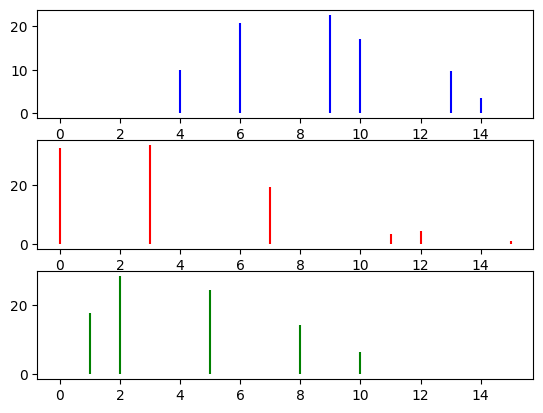

In [75]:
plt.subplot(3, 1, 1)
plt.vlines(
    x=np.arange(candidate_mz_pattern.shape[1]),
    ymin=0,
    ymax=candidate_mz_pattern[0, :] * 100,
    color="blue",
    label="candidate_mz_range",
    # linestyle="--",
)

plt.subplot(3, 1, 2)
plt.vlines(
    x=np.arange(candidate_mz_pattern.shape[1]),
    ymin=0,
    ymax=candidate_mz_pattern[1, :] * 100,
    color="red",
    label="candidate_mz_range",
    # linestyle="--",
)

plt.subplot(3, 1, 3)
plt.vlines(
    x=np.arange(candidate_mz_pattern.shape[1]),
    ymin=0,
    ymax=candidate_mz_pattern[2, :] * 100,
    color="green",
    label="candidate_mz_range",
    # linestyle="--",
)

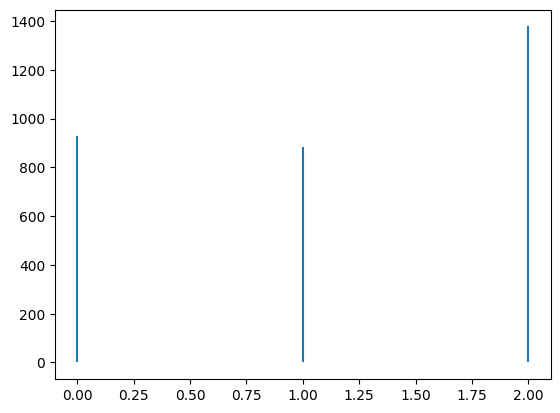

In [14]:
plt.vlines(x=[0, 1, 2], ymin=0, ymax=candidate_act.sum(axis=0), label="candidate_act")

In [15]:
np.multiply(candidate_act.sum(axis=0), candidate_mz_pattern.T).sum(axis=1)

array([288.79387178, 244.42120607, 392.89648914, 296.1748629 ,
        92.02655651, 334.03321061, 192.77713893, 169.12514039,
       195.96219309, 211.05564988, 245.85471113,  28.45774238,
        39.70407997,  90.324775  ,  32.79577544,   9.09302447])

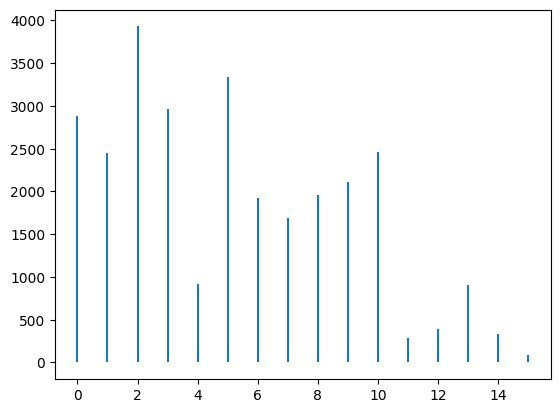

In [16]:
plt.vlines(
    x=np.arange(candidate_mz_pattern.shape[1]),
    ymin=0,
    ymax=np.multiply(candidate_act.sum(axis=0), candidate_mz_pattern.T).sum(axis=1)
    * 10,
)

([<matplotlib.axis.XTick at 0x7f00742ded70>,
 [Text(-200.0, 0, '0.85'),
  Text(0.0, 0, '0.93'),
  Text(200.0, 0, '1.01'),
  Text(400.0, 0, '1.08'),
  Text(600.0, 0, '1.16'),
  Text(800.0, 0, '1.24'),
  Text(1000.0, 0, '1.32')])

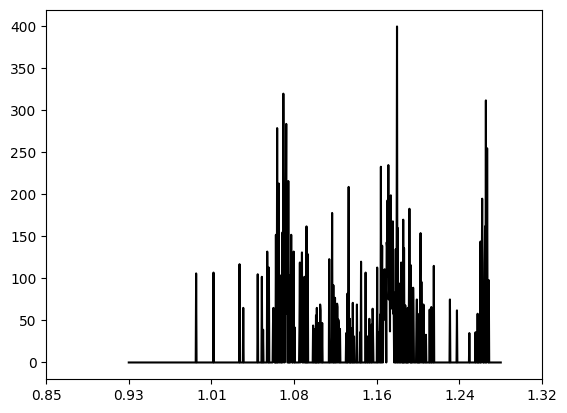

In [22]:
import matplotlib.pyplot as plt

plt.plot(
    frame_array[:, non_zero_columns].sum(axis=1).reshape(-1, 1),
    color="black",
)
# Retrieve the current x-tick positions
current_ticks = plt.gca().get_xticks()

# Calculate new labels based on the range 0.8 to 1.3
# Map the current tick range (0 to 900) to the new label range (0.8 to 1.3)
new_labels = np.linspace(
    mobility_values_df["mobility_values"].min(),
    mobility_values_df["mobility_values"].max(),
    len(current_ticks),
)

# Apply the new labels to the x-axis
plt.xticks(current_ticks, labels=np.round(new_labels, 2))

([<matplotlib.axis.XTick at 0x7efbf0b9f2b0>,
 [Text(-200.0, 0, '0.85'),
  Text(0.0, 0, '0.93'),
  Text(200.0, 0, '1.01'),
  Text(400.0, 0, '1.08'),
  Text(600.0, 0, '1.16'),
  Text(800.0, 0, '1.24'),
  Text(1000.0, 0, '1.32')])

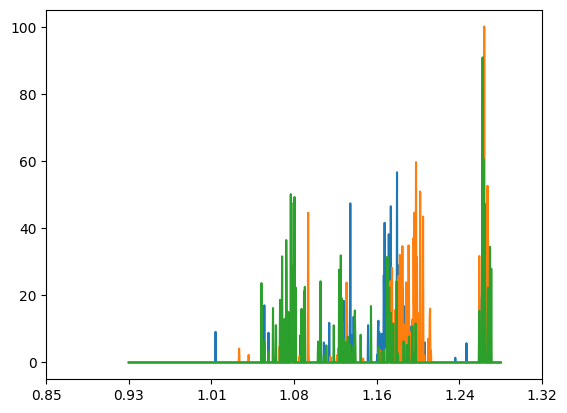

In [81]:
import matplotlib.pyplot as plt

plt.plot(candidate_act)
# Retrieve the current x-tick positions
current_ticks = plt.gca().get_xticks()

# Calculate new labels based on the range 0.8 to 1.3
# Map the current tick range (0 to 900) to the new label range (0.8 to 1.3)
new_labels = np.linspace(
    mobility_values_df["mobility_values"].min(),
    mobility_values_df["mobility_values"].max(),
    len(current_ticks),
)

# Apply the new labels to the x-axis
plt.xticks(current_ticks, labels=np.round(new_labels, 2))

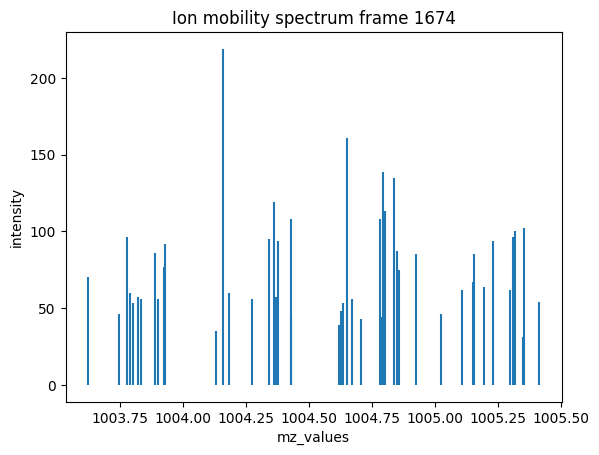

In [32]:
from utils.plot import plot_im_or_mz_int_reduced

plot_im_or_mz_int_reduced(df, group_by="mz_values")

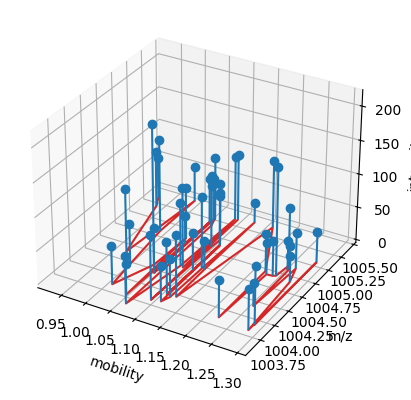

In [11]:
%autoreload 2
from utils.plot import plot_im_mz_int

df = data[
    {
        "frame_indices": 1674,
        # # "scan_indices": slice(300, 800, 10),
        "mz_values": slice(1003.5, 1005.5),
        # "mobility_values": [0.9, 1.0],
        # # "intensity_values": 50,
    }
]
plot_im_mz_int(df)

2024-09-12 10:50:36,994 - utils.plot - INFO - Dictionary entry              Modified sequence  Charge      1/K0  RT_search_left  \
25495  _ESILQRPLSLPSLHVFGDTDK_       3  0.939356          16.313   

       RT_search_right  RT_search_center  Retention time  \
25495           16.492            16.388          16.388   

       Number of data points  Number of scans  
25495                    532               13  
2024-09-12 10:50:37,004 - utils.plot - INFO - Experiment result:              Modified sequence  Charge  Calibrated retention time start  \
25495  _ESILQRPLSLPSLHVFGDTDK_       3                           16.314   

       Calibrated retention time finish      1/K0  1/K0 length  \
25495                            16.491  0.939356     0.066442   

       Number of data points  Retention length  
25495                    532           0.17627  , bounding box available: [16.314, 16.491, 0.1769999999999996, 0.906134625, 0.9725765749999999, 0.06644195]
2024-09-12 10:50:37,009 - pos

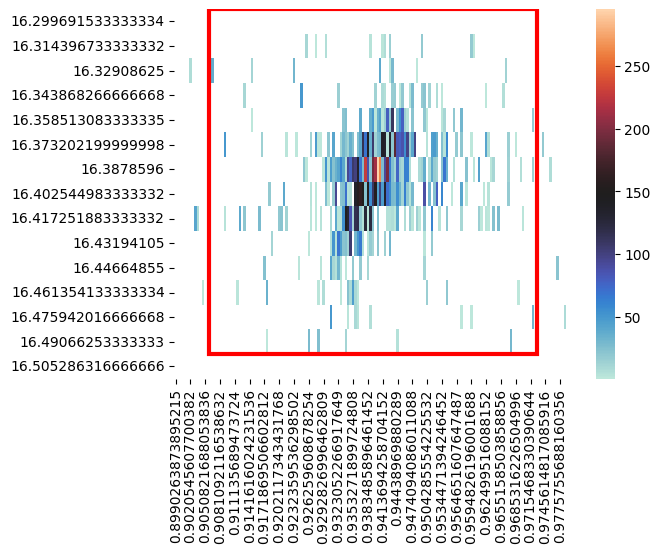

In [39]:
%autoreload 2
from utils.plot import plot_pept_im_rt_heatmap

plot_pept_im_rt_heatmap(
    pept_mz_rank=19198,
    act_3d=act_3d,
    maxquant_result_dict=maxquant_result_ref,
    maxquant_result_exp=maxquant_result_ref,
    plot_range="non_zero",
    #rt_range=(12.86, 13.27),
    #rt_range=(8)
    mobility_values_df=mobility_values_df,
    ms1scans=ms1scans,
    log_intensity=False
)

2024-07-29 12:50:00,959 - utils.plot - INFO - Dictionary entry      Modified sequence  Charge      1/K0  RT_search_left  RT_search_right  \
8977     _TFEGHDASVLK_       2  0.943375        5.320433         6.946167   

      RT_search_center  Retention time  Number of data points  Number of scans  
8977            6.1333          15.078                    518               20  
2024-07-29 12:50:00,970 - utils.plot - INFO - Experiment result:        Modified sequence  Charge  Calibrated retention time start  \
159416     _TFEGHDASVLK_       2                           6.0065   

        Calibrated retention time finish      1/K0  1/K0 length  \
159416                            6.1269  0.947821     0.041633   

        Number of data points  Retention length  
159416                    325           0.12041  , bounding box available: [6.0065, 6.1269, 0.12040000000000006, 0.9270046965000001, 0.9686381835, 0.041633487]
2024-07-29 12:50:00,976 - postprocessing.ims_3d - DEBUG - No reference 

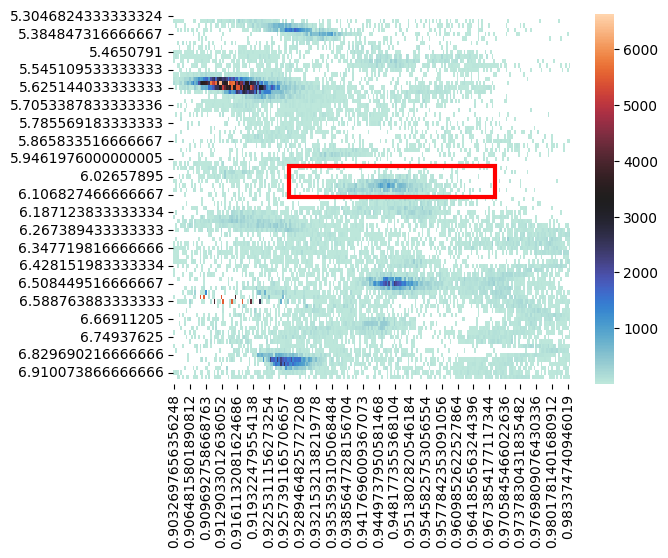

In [131]:
plot_pept_im_rt_heatmap(
    pept_mz_rank=15205,
    act_3d=act_3d,
    maxquant_result_dict=maxquant_result_ref,
    maxquant_result_exp=maxquant_result_exp,
    mobility_values_df=mobility_values_df,
    plot_range="custom",
    # rt_range=(12.86, 13.27),
    ms1scans=ms1scans,
    log_intensity=False,
)